### Crime analysis by borough

In [130]:
crime_borough_df = pd.get_dummies(data[['month', 'crime type', 'borough_london', 'stringency', 'covid']], columns = ['crime type'])

In [131]:
crime_borough_df

,month,borough_london,stringency,covid,crime type_Bicycle theft,crime type_Burglary,crime type_Criminal damage and arson,crime type_Drugs,crime type_Other crime,crime type_Other theft,crime type_Possession of weapons,crime type_Public order,crime type_Robbery,crime type_Shoplifting,crime type_Theft from the person,crime type_Vehicle crime,crime type_Violence and sexual offences
0,2018-01-01,Barking and Dagenham,0.000,0,0,1,0,0,0,0,0,0,0,0,0,0,0
1,2018-01-01,Barking and Dagenham,0.000,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,2018-01-01,Barking and Dagenham,0.000,0,0,1,0,0,0,0,0,0,0,0,0,0,0
3,2018-01-01,Barking and Dagenham,0.000,0,0,1,0,0,0,0,0,0,0,0,0,0,0
4,2018-01-01,Barking and Dagenham,0.000,0,0,0,1,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2844236,2021-09-01,Westminster,42.034,1,0,0,0,0,0,0,0,0,0,0,1,0,0
2844237,2021-09-01,Westminster,42.034,1,0,0,0,0,0,0,0,0,0,0,1,0,0
2844238,2021-09-01,Westminster,42.034,1,0,0,0,0,0,0,0,0,0,0,0,0,1
2844239,2021-09-01,Westminster,42.034,1,0,0,0,0,0,0,0,0,0,0,0,0,1


In [132]:
boroughs = crime_borough_df['borough_london'].unique().tolist()
boroughs

['Barking and Dagenham',
 'Barnet',
 'Bexley',
 'Brent',
 'Bromley',
 'Camden',
 'City of London',
 'Croydon',
 'Ealing',
 'Enfield',
 'Greenwich',
 'Hackney',
 'Hammersmith and Fulham',
 'Haringey',
 'Harrow',
 'Havering',
 'Hillingdon',
 'Hounslow',
 'Islington',
 'Kensington and Chelsea',
 'Kingston upon Thames',
 'Lambeth',
 'Lewisham',
 'Merton',
 'Newham',
 'Redbridge',
 'Richmond upon Thames',
 'Southwark',
 'Sutton',
 'Tower Hamlets',
 'Waltham Forest',
 'Wandsworth',
 'Westminster']

In [ ]:
print(f"There are {len(crime_borough_df['borough_london'].unique())} boroughs in London")

There are 33 boroughs in London


In [133]:
#creating a dataset grouped by date and borough
crime_month_by_borough = crime_borough_df.groupby(['month', 'borough_london']).agg(lambda x: x.mean() if x.name == 'stringency' or x.name == 'covid' else x.sum() )

In [ ]:
crime_month_by_borough.index

MultiIndex([('2018-01', 'Barking and Dagenham'),
            ('2018-01',               'Barnet'),
            ('2018-01',               'Bexley'),
            ('2018-01',                'Brent'),
            ('2018-01',              'Bromley'),
            ('2018-01',               'Camden'),
            ('2018-01',       'City of London'),
            ('2018-01',              'Croydon'),
            ('2018-01',               'Ealing'),
            ('2018-01',              'Enfield'),
            ...
            ('2021-09',               'Merton'),
            ('2021-09',               'Newham'),
            ('2021-09',            'Redbridge'),
            ('2021-09', 'Richmond upon Thames'),
            ('2021-09',            'Southwark'),
            ('2021-09',               'Sutton'),
            ('2021-09',        'Tower Hamlets'),
            ('2021-09',       'Waltham Forest'),
            ('2021-09',           'Wandsworth'),
            ('2021-09',          'Westminster')],
   

In [ ]:
#data for an example borough
crime_month_by_borough.loc(axis = 0)[:, 'Barnet'].sum()

stringency                                  1249.474141
covid                                         19.000000
crime type_Bicycle theft                     872.000000
crime type_Burglary                        11616.000000
crime type_Criminal damage and arson        6861.000000
crime type_Drugs                            3069.000000
crime type_Other crime                      1126.000000
crime type_Other theft                     11910.000000
crime type_Possession of weapons             463.000000
crime type_Public order                     6023.000000
crime type_Robbery                          2966.000000
crime type_Shoplifting                      5550.000000
crime type_Theft from the person            2552.000000
crime type_Vehicle crime                   19731.000000
crime type_Violence and sexual offences    24848.000000
dtype: float64

In [ ]:
crime_month_by_borough.index

MultiIndex([('2018-01', 'Barking and Dagenham'),
            ('2018-01',               'Barnet'),
            ('2018-01',               'Bexley'),
            ('2018-01',                'Brent'),
            ('2018-01',              'Bromley'),
            ('2018-01',               'Camden'),
            ('2018-01',       'City of London'),
            ('2018-01',              'Croydon'),
            ('2018-01',               'Ealing'),
            ('2018-01',              'Enfield'),
            ...
            ('2021-09',               'Merton'),
            ('2021-09',               'Newham'),
            ('2021-09',            'Redbridge'),
            ('2021-09', 'Richmond upon Thames'),
            ('2021-09',            'Southwark'),
            ('2021-09',               'Sutton'),
            ('2021-09',        'Tower Hamlets'),
            ('2021-09',       'Waltham Forest'),
            ('2021-09',           'Wandsworth'),
            ('2021-09',          'Westminster')],
   

In [134]:
#removing covid variable as it is not needed for correlation
crime_month_by_borough_ = crime_month_by_borough.drop('covid', axis = 1)

In [135]:
#getting correlation matrices for all boroughs
borough_corr = []
for index, borough in enumerate(crime_month_by_borough.index):
  borough_df = crime_month_by_borough_.loc(axis = 0)[:, f'{borough[1]}']
  borough_corr.append(borough_df.corr())
  
borough_corr  

[                                         stringency  crime type_Bicycle theft  \
 stringency                                 1.000000                 -0.086743   
 crime type_Bicycle theft                  -0.086743                  1.000000   
 crime type_Burglary                       -0.685290                 -0.267423   
 crime type_Criminal damage and arson      -0.182760                  0.349654   
 crime type_Drugs                           0.735210                  0.023616   
 crime type_Other crime                     0.262372                  0.169916   
 crime type_Other theft                    -0.553371                  0.120134   
 crime type_Possession of weapons          -0.095824                  0.207045   
 crime type_Public order                    0.351613                  0.398477   
 crime type_Robbery                        -0.670583                  0.097145   
 crime type_Shoplifting                    -0.072687                 -0.063596   
 crime type_Thef

Text(0.5, 1.0, 'Crime Types vs Stringency Barking and Dagenham')

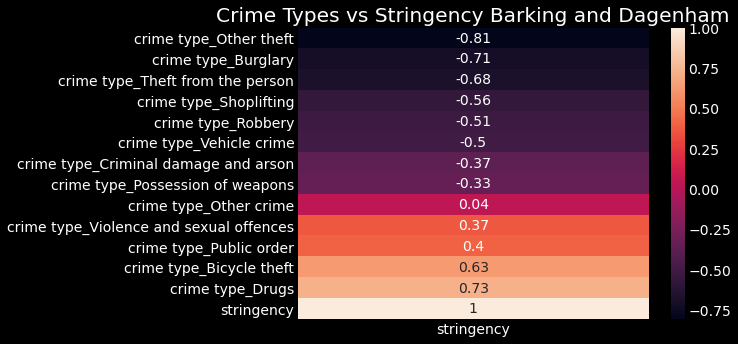

In [139]:
#Example: correlation matrix for stringency and crime types for Barnet
plt.figure(figsize = (7, 5))
sns.heatmap(borough_corr[1]['stringency'].sort_values().to_frame(), annot = True)
plt.title('Crime Types vs Stringency Barking and Dagenham')

In [ ]:
boroughs = list(crime_borough_df['borough_london'].unique())

In [ ]:
#getting the correlation matrix with stringency only 
boroughs_stringe = []
for i in range(len(boroughs)):
  boroughs_stringe.append(borough_corr[i]['stringency'].sort_values().to_frame())
boroughs_stringe

[                                         stringency
 crime type_Burglary                       -0.685290
 crime type_Robbery                        -0.670583
 crime type_Vehicle crime                  -0.557920
 crime type_Other theft                    -0.553371
 crime type_Theft from the person          -0.390186
 crime type_Criminal damage and arson      -0.182760
 crime type_Possession of weapons          -0.095824
 crime type_Bicycle theft                  -0.086743
 crime type_Shoplifting                    -0.072687
 crime type_Other crime                     0.262372
 crime type_Violence and sexual offences    0.276561
 crime type_Public order                    0.351613
 crime type_Drugs                           0.735210
 stringency                                 1.000000,
                                          stringency
 crime type_Other theft                    -0.808352
 crime type_Burglary                       -0.708831
 crime type_Theft from the person          -0

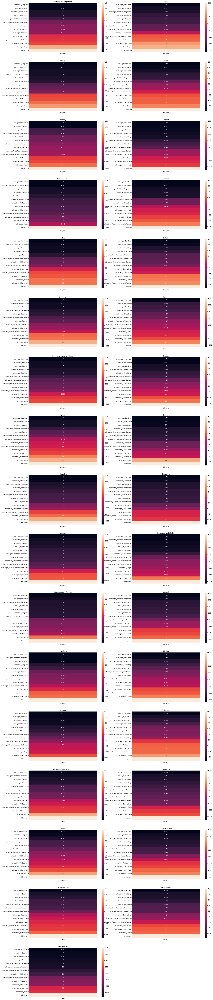

In [ ]:
#Correlation between crime types and stringency by London borough

fig, axes = plt.subplots(nrows=17, ncols=2, figsize=(26, 140))  # define the figure and subplots
axes = axes.ravel()  # array to 1D
dfg =   boroughs_stringe
index = list(range(33))


for index,  group, data, ax in zip(index, boroughs, dfg, axes):
  
  
  sns.heatmap(data, annot = True, ax = ax)
  ax.set_title(group)
fig.delaxes(axes[33])

# Analysis of the relationship between stringency and crimes types by borough shows that the strength of the relationship varies in degree depending on a borough.
# The strongest impact of Covid-19 on crime reduction was in inner London, on average around 0.8 - 0.9 with theft related crimes (the strongest negative correlation was -0.93 in Westminster, which notably showed only negative correlations with 
# all the crime types (-0.93 to - 0.14). The only theft related crime that noted weak to moderate positive relationship with Covid-19 measures was bike theft. 
# Overall, most of the boroughs noted positive correlation with drug misuse - the least impact on this type of offense was in inner London boroughs, which are office areas. In residential areas of inner London, the effect on drug-related offences 
# followed the general trend of positive correlation, e.g. Greenwich, + 0.72. In 10 of the London boroughs there was a strong positive correlation with drug-related offences - around 0.6 - 0.7, in 8 of the boroughs the relationship was moderate 
# (between 0.41 - 0.59), in the rest of the boroughs the relationship was weak positive or there was no impact of stringency. Violence and sexual offences ranged from moderate positive (0.58) to weak negative (-0.46) relationship, mostly showing no relationship at all 
# or a weak positive relationship, with two exceptions -.07 in Westminster and -0.83 in the City of London. Public order offences also showed from moderate through weak positive correlation to no correlation with stringency.

  

In [ ]:
#Analyzing crime count by borough

In [ ]:
#getting a dataset that is balanced with respect to dates before and during pandemic
dates_balanced = crime_borough_df['month'].unique().tolist()[7:]

In [ ]:
def in_dates(item):
    if item in dates_balanced:
        return True
    else: return False

In [ ]:
crime_borough_df_balanced = crime_borough_df[crime_borough_df['month'].apply(in_dates)]


In [ ]:
crime_borough_df_balanced

,month,borough_london,stringency,covid,crime type_Bicycle theft,crime type_Burglary,crime type_Criminal damage and arson,crime type_Drugs,crime type_Other crime,crime type_Other theft,crime type_Possession of weapons,crime type_Public order,crime type_Robbery,crime type_Shoplifting,crime type_Theft from the person,crime type_Vehicle crime,crime type_Violence and sexual offences
9781,2018-08,Barking and Dagenham,0.000,0,1,0,0,0,0,0,0,0,0,0,0,0,0
9782,2018-08,Barking and Dagenham,0.000,0,0,1,0,0,0,0,0,0,0,0,0,0,0
9783,2018-08,Barking and Dagenham,0.000,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9784,2018-08,Barking and Dagenham,0.000,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9785,2018-08,Barking and Dagenham,0.000,0,0,0,0,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2844236,2021-09,Westminster,42.034,1,0,0,0,0,0,0,0,0,0,0,1,0,0
2844237,2021-09,Westminster,42.034,1,0,0,0,0,0,0,0,0,0,0,1,0,0
2844238,2021-09,Westminster,42.034,1,0,0,0,0,0,0,0,0,0,0,0,0,1
2844239,2021-09,Westminster,42.034,1,0,0,0,0,0,0,0,0,0,0,0,0,1


In [ ]:
#removinng the stringency column as it is not needed for the analyzis of crime counts by borough
crime_borough_df_balanced = crime_borough_df_balanced.drop('stringency', axis = 1)
crime_borough_df_balanced

,month,borough_london,covid,crime type_Bicycle theft,crime type_Burglary,crime type_Criminal damage and arson,crime type_Drugs,crime type_Other crime,crime type_Other theft,crime type_Possession of weapons,crime type_Public order,crime type_Robbery,crime type_Shoplifting,crime type_Theft from the person,crime type_Vehicle crime,crime type_Violence and sexual offences
9781,2018-08,Barking and Dagenham,0,1,0,0,0,0,0,0,0,0,0,0,0,0
9782,2018-08,Barking and Dagenham,0,0,1,0,0,0,0,0,0,0,0,0,0,0
9783,2018-08,Barking and Dagenham,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9784,2018-08,Barking and Dagenham,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9785,2018-08,Barking and Dagenham,0,0,0,0,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2844236,2021-09,Westminster,1,0,0,0,0,0,0,0,0,0,0,1,0,0
2844237,2021-09,Westminster,1,0,0,0,0,0,0,0,0,0,0,1,0,0
2844238,2021-09,Westminster,1,0,0,0,0,0,0,0,0,0,0,0,0,1
2844239,2021-09,Westminster,1,0,0,0,0,0,0,0,0,0,0,0,0,1


In [ ]:
#getting a dataset groupped by date and borough
crime_month_by_borough_balanced = crime_borough_df_balanced.groupby(['month', 'borough_london']).agg(lambda x: x.mean() if x.name == 'covid' else x.sum() )

In [ ]:
crime_month_by_borough_balanced

covid  ...  crime type_Violence and sexual offences
month   borough_london               ...                                         
2018-08 Barking and Dagenham      0  ...                                      402
        Barnet                    0  ...                                      508
        Bexley                    0  ...                                      307
        Brent                     0  ...                                      640
        Bromley                   0  ...                                      404
...                             ...  ...                                      ...
2021-09 Sutton                    1  ...                                      346
        Tower Hamlets             1  ...                                      735
        Waltham Forest            1  ...                                      518
        Wandsworth                1  ...                                      617
        Westminster               1  ...                                      870

[1254 rows x 14 columns]

In [ ]:
#getting a monthly crime count for each crime type and each borough
borough_crime_count_balanced = []
for index, borough in enumerate(boroughs):
  borough_df = crime_month_by_borough_balanced.loc(axis = 0)[:, f'{borough}']
  borough_crime_count_balanced.append(borough_df.groupby('covid').sum())
borough_crime_count_balanced[0]

,crime type_Bicycle theft,crime type_Burglary,crime type_Criminal damage and arson,crime type_Drugs,crime type_Other crime,crime type_Other theft,crime type_Possession of weapons,crime type_Public order,crime type_Robbery,crime type_Shoplifting,crime type_Theft from the person,crime type_Vehicle crime,crime type_Violence and sexual offences
covid,,,,,,,,,,,,,
0,282,2502,2111.0,1514,327.0,2969,205.0,1474,1415,1129,893,4054,8307
1,285,1735,2125.0,2292,401.0,2556,189.0,1758,860,1164,658,3395,9092


In [ ]:
borough_dfs = []
for index, borough in enumerate(crime_month_by_borough.index):
  borough_df_2 = crime_month_by_borough_balanced.loc(axis = 0)[:, f'{borough[1]}']
  borough_dfs.append(borough_df_2)

In [ ]:
#Data for an example borough
borough_dfs[0]

,,covid,crime type_Bicycle theft,crime type_Burglary,crime type_Criminal damage and arson,crime type_Drugs,crime type_Other crime,crime type_Other theft,crime type_Possession of weapons,crime type_Public order,crime type_Robbery,crime type_Shoplifting,crime type_Theft from the person,crime type_Vehicle crime,crime type_Violence and sexual offences
month,borough_london,,,,,,,,,,,,,,
2018-08,Barking and Dagenham,0,27,103,107,62,13,156,10,88,58,62,33,205,402
2018-09,Barking and Dagenham,0,21,138,99,69,11,146,13,82,60,52,23,203,403
2018-10,Barking and Dagenham,0,17,126,138,61,10,169,17,67,70,56,43,257,441
2018-11,Barking and Dagenham,0,10,144,107,68,14,175,14,61,77,66,66,228,403
2018-12,Barking and Dagenham,0,12,196,90,61,14,147,10,69,60,62,48,191,436
2019-01,Barking and Dagenham,0,20,160,99,75,14,156,7,50,72,52,45,243,431
2019-02,Barking and Dagenham,0,15,128,127,63,25,170,11,70,65,59,51,236,399
2019-03,Barking and Dagenham,0,13,127,131,106,14,180,20,83,73,54,47,210,448
2019-04,Barking and Dagenham,0,13,120,112,87,18,168,9,80,86,63,54,228,412


In [ ]:
#Example: bicycle theft crime count for borough Barking and Dagenham
borough_to_plot = borough_crime_count_balanced[0].reset_index()
borough_to_plot[['covid', 'crime type_Bicycle theft']]


,covid,crime type_Bicycle theft
0,0,282
1,1,285


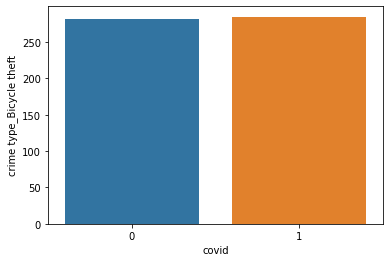

In [ ]:
data = borough_to_plot[['covid', 'crime type_Bicycle theft']]
sns.barplot(x = 'covid', y = 'crime type_Bicycle theft', data = data)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

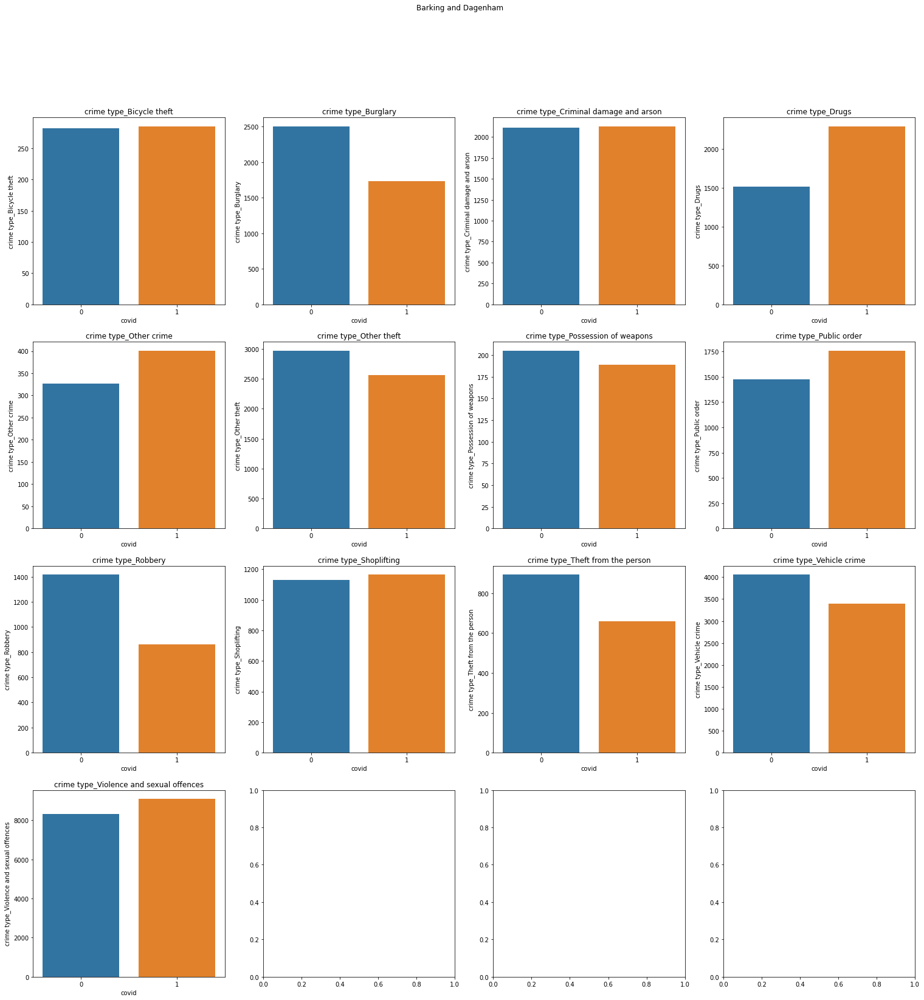

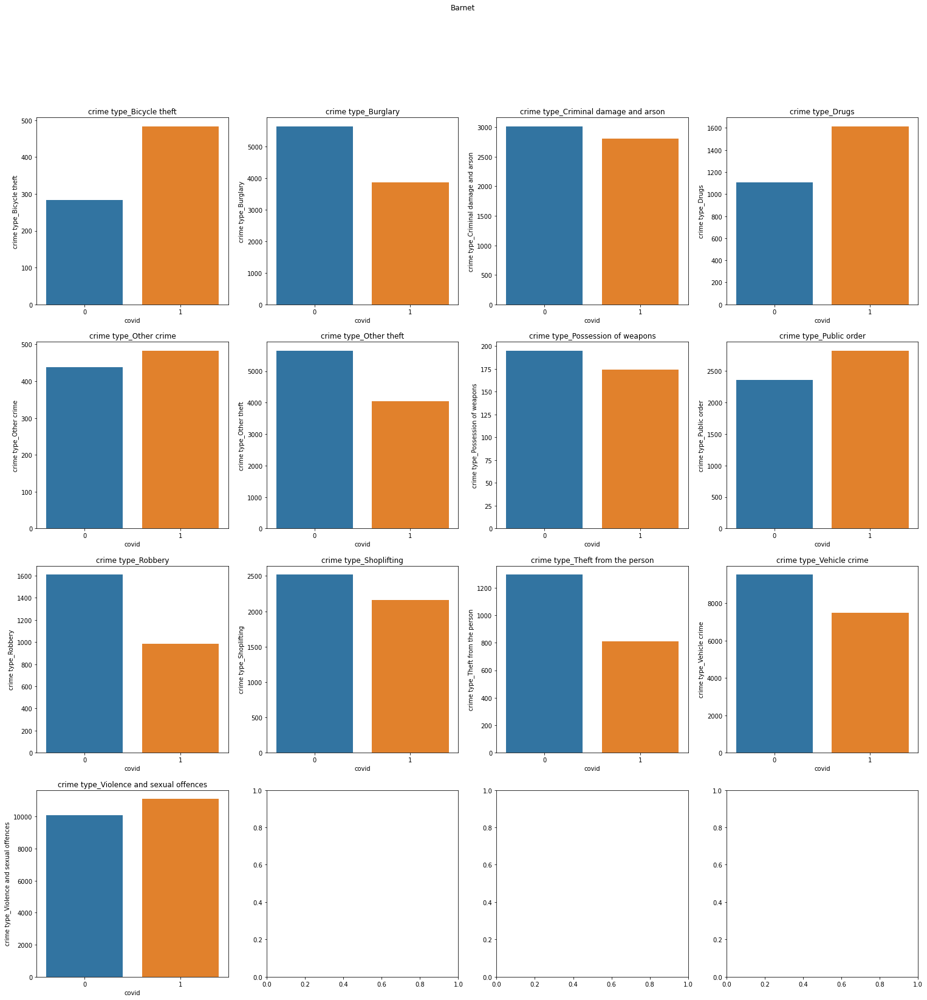

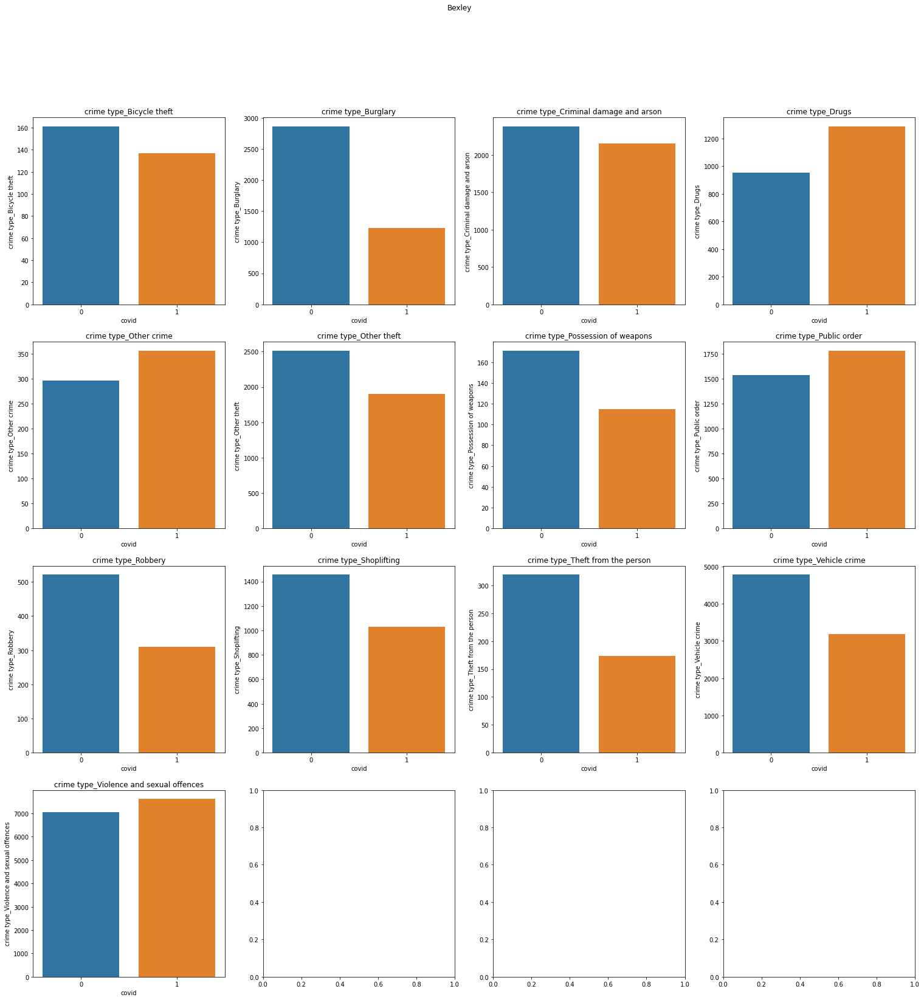

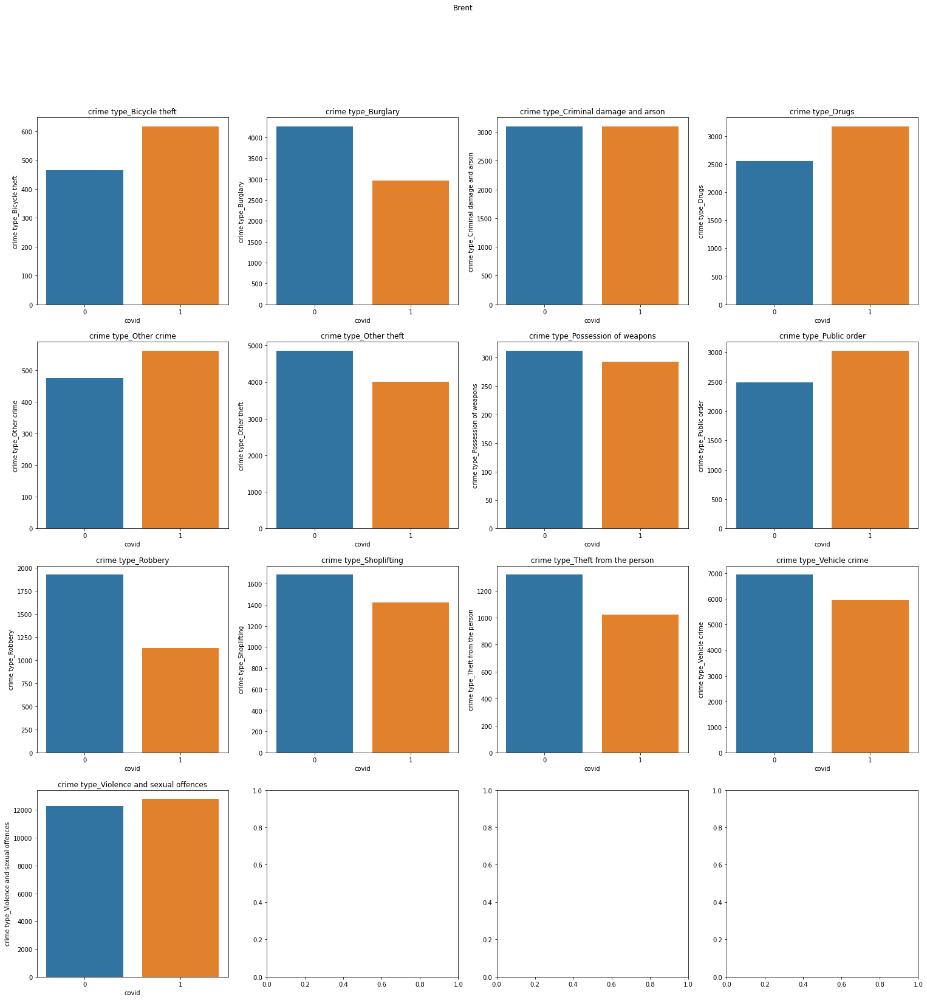

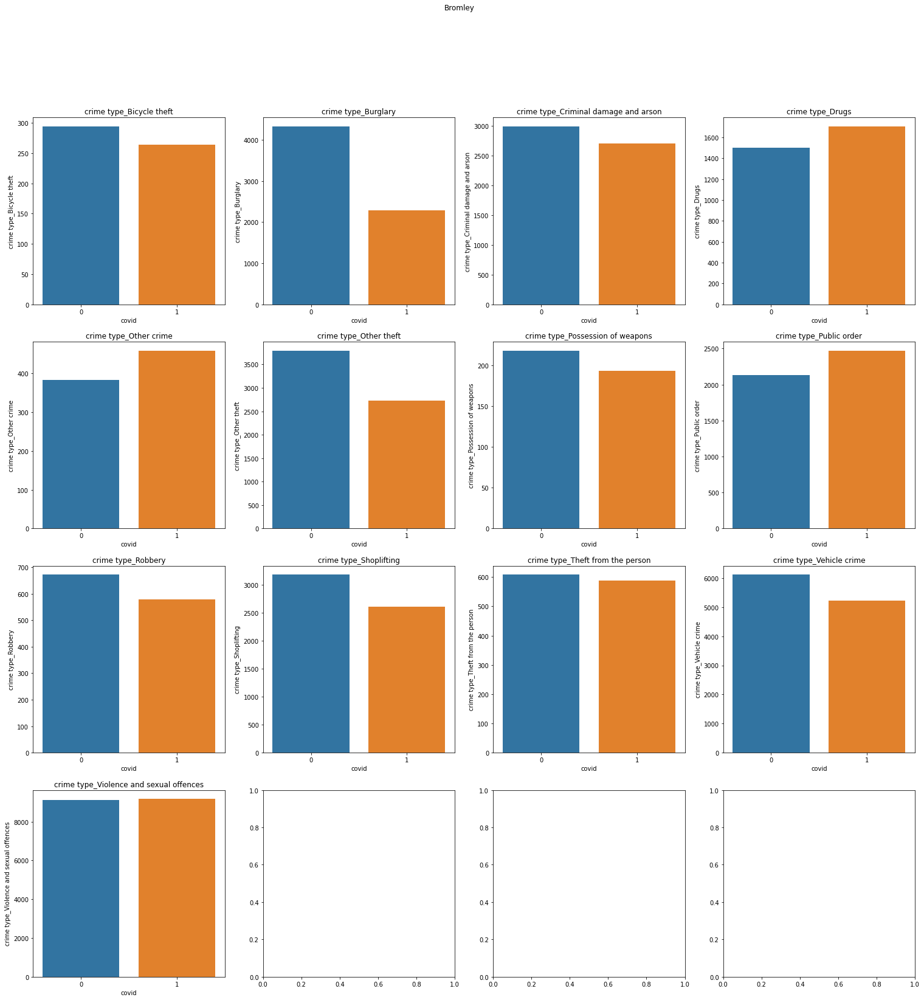

...

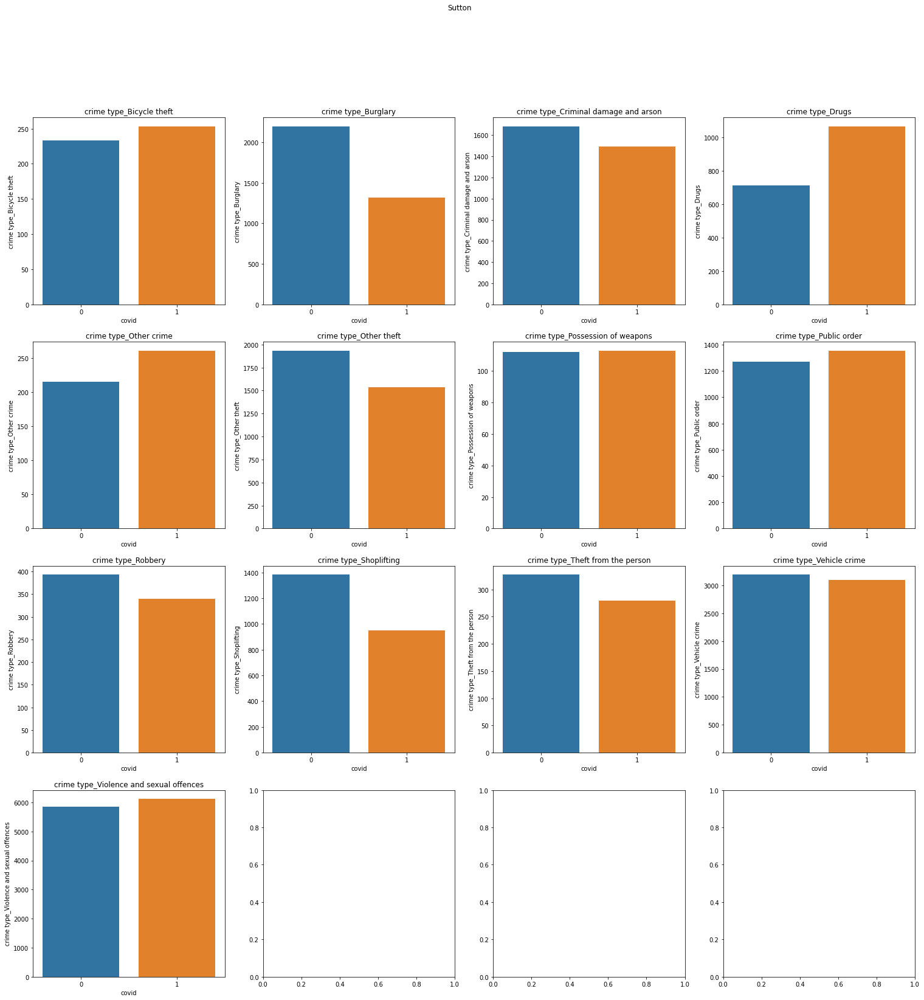

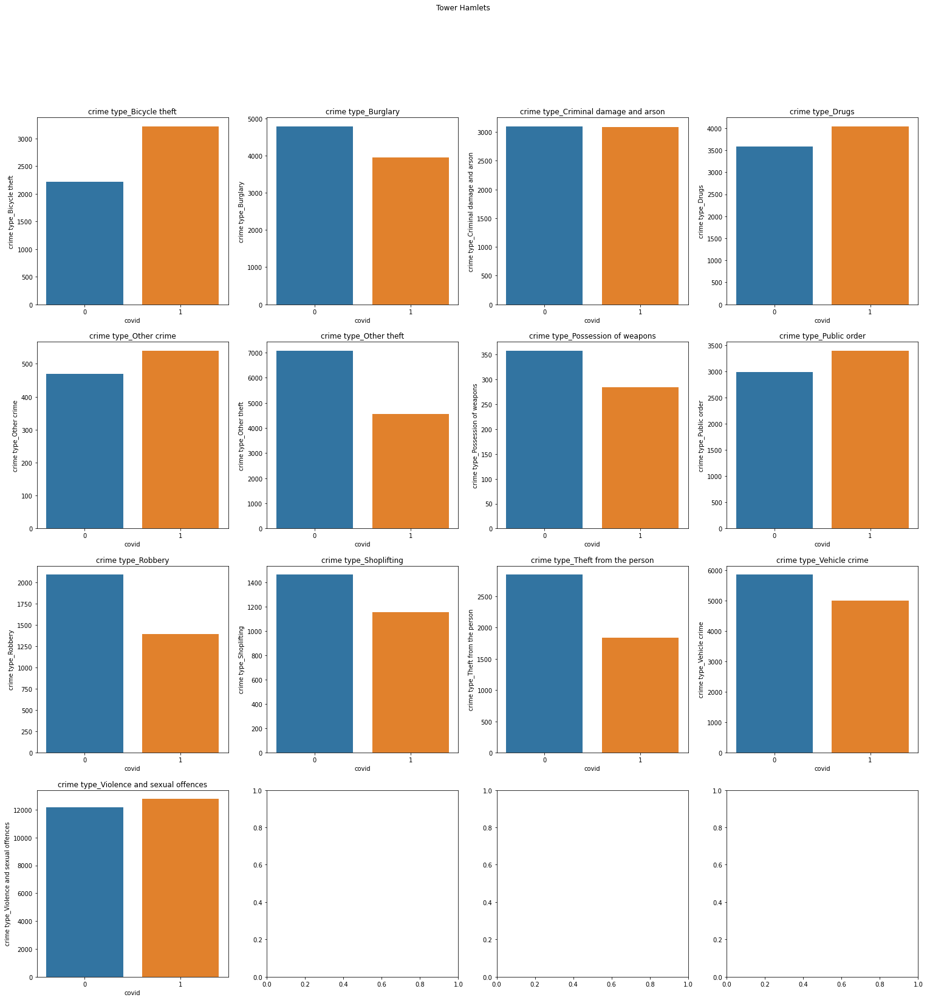

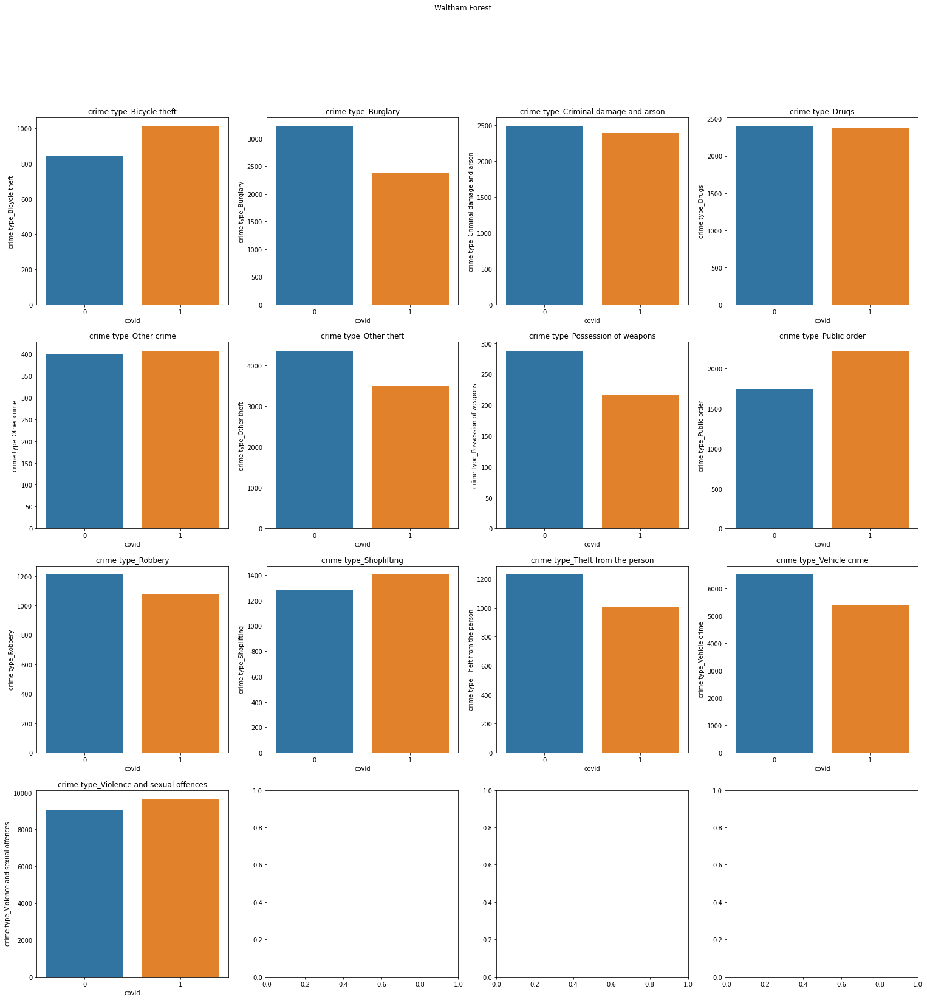

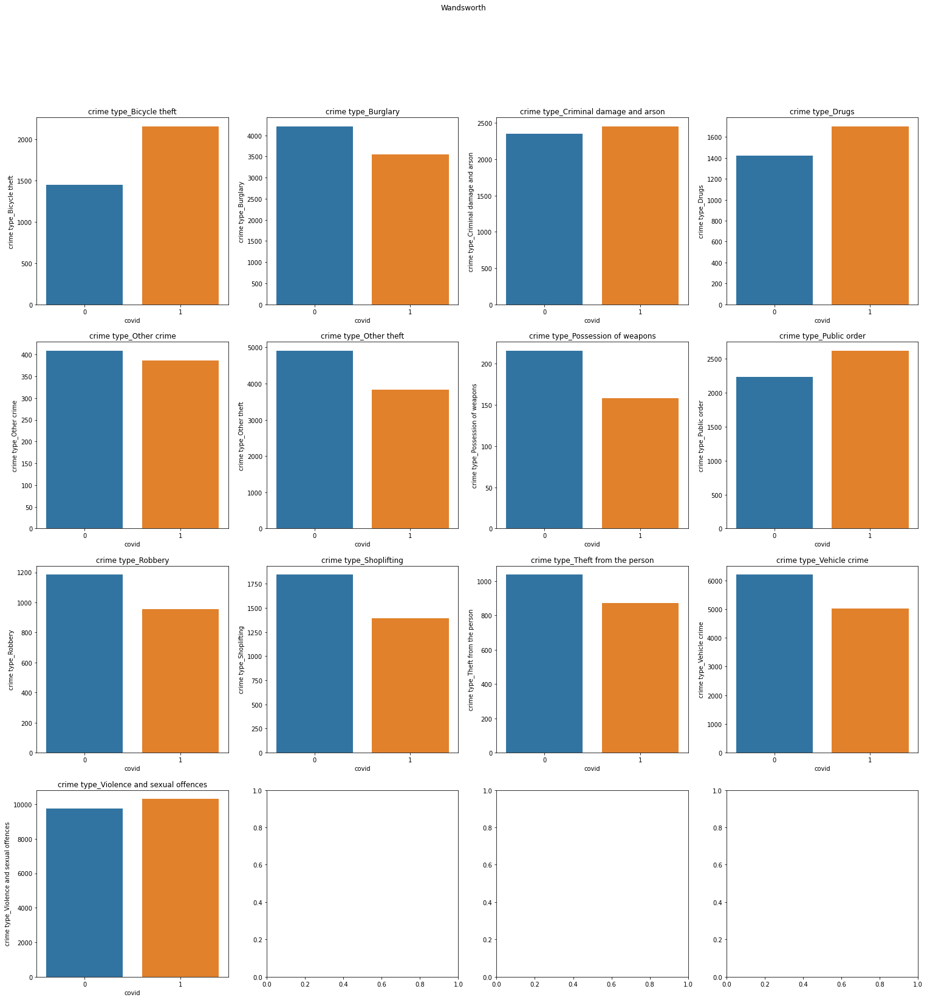

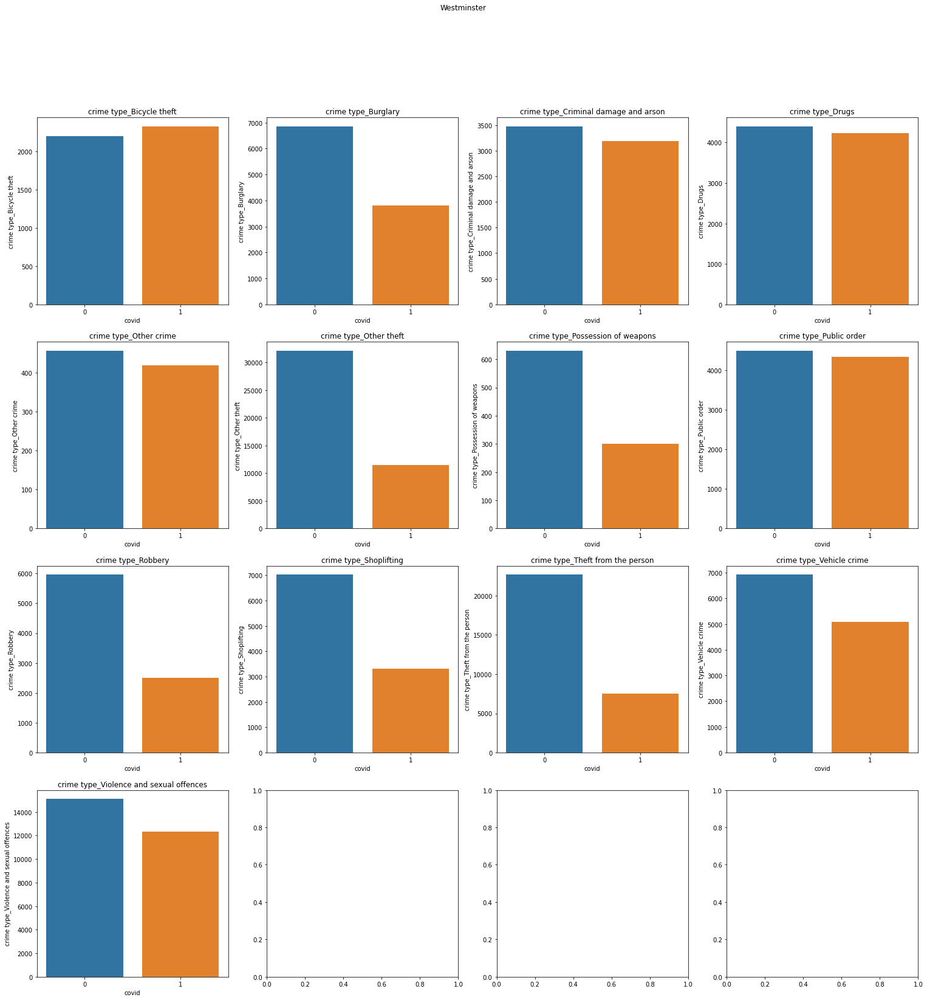

In [ ]:
#Crime counts by type pre and during pandemic for each borough 

for i in range(len(boroughs)): 
  fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(26, 26))  # define the figure and subplots
  axes = axes.ravel()  # array to 1D
  dfg =   borough_to_plot.columns.to_list()[1:]
  index = list(range(13))


  for index, crime, ax in zip(index, dfg, axes):
    feature =  borough_crime_count_balanced[i].reset_index()[['covid', crime]]
    sns.barplot(x = 'covid', y = crime, data = feature, ax = ax)
    ax.set_title(crime)
  # fig.delaxes(axes[13])
  fig.suptitle(crime_borough_df['borough_london'].unique()[i])

